In [1]:
import pickle
import os
import pandas as pd
from matplotlib import pyplot as plt
os.chdir(os.path.expanduser('~/wcEcoli/out/data _from_MBP/sherlock_data/135731__gfp_shift_minimal_media_DL_05092024/gfp_shift_minimal_media_avg_PC_data_csvs_DL_05092024/filtered csvs/'))
# noinspection PyUnresolvedReferences
import numpy as np
import polars as pl
import plotly.graph_objects as go
from models.ecoli.analysis import variantAnalysisPlot
from wholecell.analysis.analysis_tools import (exportFigure,
	read_bulk_molecule_counts, read_stacked_bulk_molecules, read_stacked_columns)
from wholecell.io.tablereader import TableReader

In [2]:
name_front = 'wcm_filter_1_monomers_var_'
name_back = '_startGen_14.csv'

v1 = pd.read_csv(name_front + '1' + name_back)
v2 = pd.read_csv(name_front + '2' + name_back)
v3 = pd.read_csv(name_front + '3' + name_back)
v4 = pd.read_csv(name_front + '4' + name_back)
v5 = pd.read_csv(name_front + '5' + name_back)
v6 = pd.read_csv(name_front + '6' + name_back)
v7 = pd.read_csv(name_front + '7' + name_back)
v8 = pd.read_csv(name_front + '8' + name_back)
v9 = pd.read_csv(name_front + '9' + name_back)
v10 = pd.read_csv(name_front + '10' + name_back)
v11 = pd.read_csv(name_front + '11' + name_back)
v12 = pd.read_csv(name_front + '12' + name_back)
v13 = pd.read_csv(name_front + '13' + name_back)
v14 = pd.read_csv(name_front + '14' + name_back)
v15 = pd.read_csv(name_front + '15' + name_back)
v16 = pd.read_csv(name_front + '16' + name_back)
v17 = pd.read_csv(name_front + '17' + name_back)
v18 = pd.read_csv(name_front + '18' + name_back)
v19 = pd.read_csv(name_front + '19' + name_back)
v20 = pd.read_csv(name_front + '20' + name_back)


In [3]:
# define the legends: 
str1 = "Var 1 (NGE: 7, TE: 5)"
str2 = "Var 2 (NGE: 7, TE: 1)"
str3 = "Var 3 (NGE: 7, TE: 0.1)"
str4 = "Var 4 (NGE: 7, TE: 0)"
str5 = "Var 5 (NGE: 7, TE: 10)"
str6 = "Var 6 (NGE: 8, TE: 5)"
str7 = "Var 7 (NGE: 8, TE: 1)"
str8 = "Var 8 (NGE: 8, TE: 0.1)"
str9 = "Var 9 (NGE: 8, TE: 0)"
str10 = "Var 10 (NGE: 8, TE: 10)"
str11 = "Var 11 (NGE: 9, TE: 5)"
str12 = "Var 12 (NGE: 9, TE: 1)"
str13 = "Var 13 (NGE: 9, TE: 0.1)"
str14 = "Var 14 (NGE: 9, TE: 0)"
str15 = "Var 15 (NGE: 9, TE: 10)"
str16 = "Var 16 (NGE: 10, TE: 5)"
str17 = "Var 17 (NGE: 10, TE: 1)"
str18 = "Var 18 (NGE: 10, TE: 0.1)"
str19 = "Var 19 (NGE: 10, TE: 0)"
str20 = "Var 20 (NGE: 10, TE: 10)"


OK do only log10 to the data: 

In [4]:
# 2: Anaylze only the log data:
def log10_data(df):
    pl_df = pl.DataFrame(df)
    name = pl_df.columns[2]
    pl_df = pl_df.rename({"var_0_avg_PCs": "Control_Variant", name: "Experimental_Variant"})
    
    pl_df = pl_df.with_columns(pl.col("Control_Variant").log10().alias("log10_Control_Variant"))
    pl_df = pl_df.with_columns(pl.col("Experimental_Variant").log10().alias("log10_Experimental_Variant"))

    df_log10 = pl_df.select(["filtered_monomer_ids","log10_Control_Variant", "log10_Experimental_Variant"])
    df_log10 = df_log10.to_pandas()
    return df_log10

# apply log10 to the data: 
v1_log10 = log10_data(v1)
v2_log10 = log10_data(v2)
v3_log10 = log10_data(v3)
v4_log10 = log10_data(v4)
v5_log10 = log10_data(v5)
v6_log10 = log10_data(v6)
v7_log10 = log10_data(v7)
v8_log10 = log10_data(v8)
v9_log10 = log10_data(v9)
v10_log10 = log10_data(v10)
v11_log10 = log10_data(v11)
v12_log10 = log10_data(v12)
v13_log10 = log10_data(v13)
v14_log10 = log10_data(v14)
v15_log10 = log10_data(v15)
v16_log10 = log10_data(v16)
v17_log10 = log10_data(v17)
v18_log10 = log10_data(v18)
v19_log10 = log10_data(v19)
v20_log10 = log10_data(v20)


# NEW GENE EXPRESSION INDEX: 7

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index set to 7 \n plotted against the control variant')

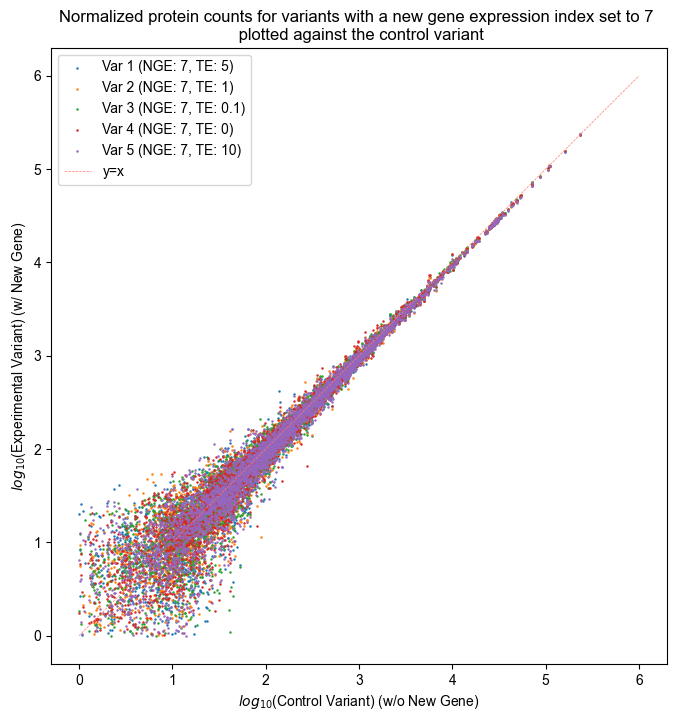

In [5]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(8, 8))

# plot the data:
plt.scatter(v1_log10.log10_Control_Variant, v1_log10.log10_Experimental_Variant, .6);
plt.scatter(v2_log10.log10_Control_Variant, v2_log10.log10_Experimental_Variant, .6);
plt.scatter(v3_log10.log10_Control_Variant, v3_log10.log10_Experimental_Variant, .6);
plt.scatter(v4_log10.log10_Control_Variant, v4_log10.log10_Experimental_Variant, .6);
plt.scatter(v5_log10.log10_Control_Variant, v5_log10.log10_Experimental_Variant, .6);

# find the maximum value:
max_vals = [max(v1_log10.log10_Control_Variant), max(v1_log10.log10_Experimental_Variant), max(v2_log10.log10_Control_Variant), max(v2_log10.log10_Experimental_Variant), max(v3_log10.log10_Control_Variant), max(v3_log10.log10_Experimental_Variant), max(v4_log10.log10_Control_Variant), max(v4_log10.log10_Experimental_Variant), max(v5_log10.log10_Control_Variant), max(v5_log10.log10_Experimental_Variant)]; max_val = round(max(max_vals)) + 1;

# plot a y=x string
yxvals= np.linspace(0, max_val, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str1, str2, str3, str4, str5, yxstr]


plt.legend(legend)
plt.axis('square')
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index set to 7 \n plotted against the control variant")

In [6]:
fig = go.Figure()
names1 = v1_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v1_log10.log10_Control_Variant,y=v1_log10.log10_Experimental_Variant, hovertext=names1,
                    mode='markers',
                    name=str1))

names2 = v2_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v2_log10.log10_Control_Variant,y=v2_log10.log10_Experimental_Variant, hovertext=names2,
                    mode='markers',
                    name=str2))

names3 = v3_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v3_log10.log10_Control_Variant,y=v3_log10.log10_Experimental_Variant, hovertext=names3,
                    mode='markers',
                    name=str3))

names4 = v4_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v4_log10.log10_Control_Variant,y=v4_log10.log10_Experimental_Variant, hovertext=names4,
                    mode='markers',
                    name=str4))

names5 = v5_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v5_log10.log10_Control_Variant,y=v5_log10.log10_Experimental_Variant, hovertext=names5,
                    mode='markers',
                    name=str5))

# make the marker size smaller:
fig.update_traces(marker=dict(size=2))

# title and labels:
fig.update_layout(title="Protein counts for experimental variants with a new gene expression index set to 7")

# add axis labels:
fig.update_xaxes(title_text="log10(Control Variant)")
fig.update_yaxes(title_text="log10(Experimental Variant) (w/ New Gene)")

fig.update_layout(
    autosize=False,
    width=1000,
    height=800)
fig.show()

# NEW GENE EXPRESSION INDEX: 8

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index set to 8 \n plotted against the control variant')

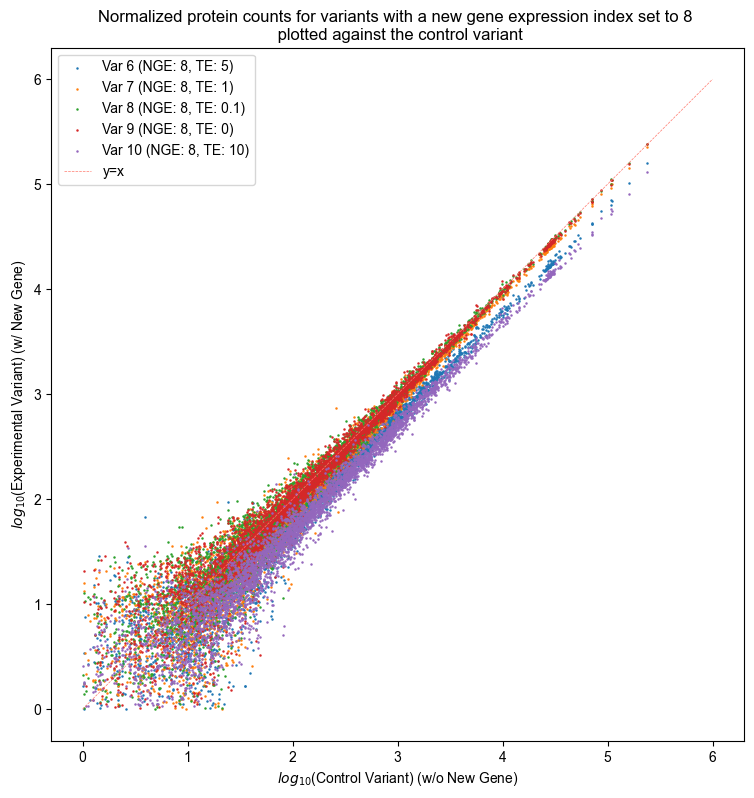

In [7]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(9, 9))

# plot the data:
plt.scatter(v6_log10.log10_Control_Variant, v6_log10.log10_Experimental_Variant, .6);
plt.scatter(v7_log10.log10_Control_Variant, v7_log10.log10_Experimental_Variant, .6);
plt.scatter(v8_log10.log10_Control_Variant, v8_log10.log10_Experimental_Variant, .6);
plt.scatter(v9_log10.log10_Control_Variant, v9_log10.log10_Experimental_Variant, .6);
plt.scatter(v10_log10.log10_Control_Variant, v10_log10.log10_Experimental_Variant, .6);

# find the maximum value:
max_vals = [max(v6_log10.log10_Control_Variant), max(v6_log10.log10_Experimental_Variant), max(v7_log10.log10_Control_Variant), max(v7_log10.log10_Experimental_Variant), max(v8_log10.log10_Control_Variant), max(v8_log10.log10_Experimental_Variant), max(v9_log10.log10_Control_Variant), max(v9_log10.log10_Experimental_Variant), max(v10_log10.log10_Control_Variant), max(v10_log10.log10_Experimental_Variant)]; max_val = round(max(max_vals)) + 1;

# plot a y=x string
yxvals= np.linspace(0, max_val, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str6, str7, str8, str9, str10, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index set to 8 \n plotted against the control variant")


In [8]:
fig = go.Figure()
names6 = v6_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v6_log10.log10_Control_Variant,y=v6_log10.log10_Experimental_Variant, hovertext=names6,
                    mode='markers',
                    name=str6))

names7 = v7_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v7_log10.log10_Control_Variant,y=v7_log10.log10_Experimental_Variant, hovertext=names7,
                    mode='markers',
                    name=str7))

names8 = v8_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v8_log10.log10_Control_Variant,y=v8_log10.log10_Experimental_Variant, hovertext=names8,
                    mode='markers',
                    name=str8))

names9 = v9_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v9_log10.log10_Control_Variant,y=v9_log10.log10_Experimental_Variant, hovertext=names9,
                    mode='markers',
                    name=str9))

names10 = v10_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v10_log10.log10_Control_Variant,y=v10_log10.log10_Experimental_Variant, hovertext=names10,
                    mode='markers',
                    name=str10))

# make the marker size smaller:
fig.update_traces(marker=dict(size=2))

# title and labels:
fig.update_layout(title="Protein counts for experimental variants with a new gene expression index set to 8")

# add axis labels:
fig.update_xaxes(title_text="log10(Control Variant)")
fig.update_yaxes(title_text="log10(Experimental Variant) (w/ New Gene)")

fig.update_layout(
    autosize=False,
    width=1000,
    height=800)
fig.show()

# resize the plot so that only data above 2 is shown:
fig.update_yaxes(range=[3, 5.5])
fig.update_xaxes(range=[3, 5.5])

# make the marker size bigger:
fig.update_traces(marker=dict(size=3))
fig.show()

# NEW GENE EXPRESSION INDEX: 9

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index set to 9 \n plotted against the control variant')

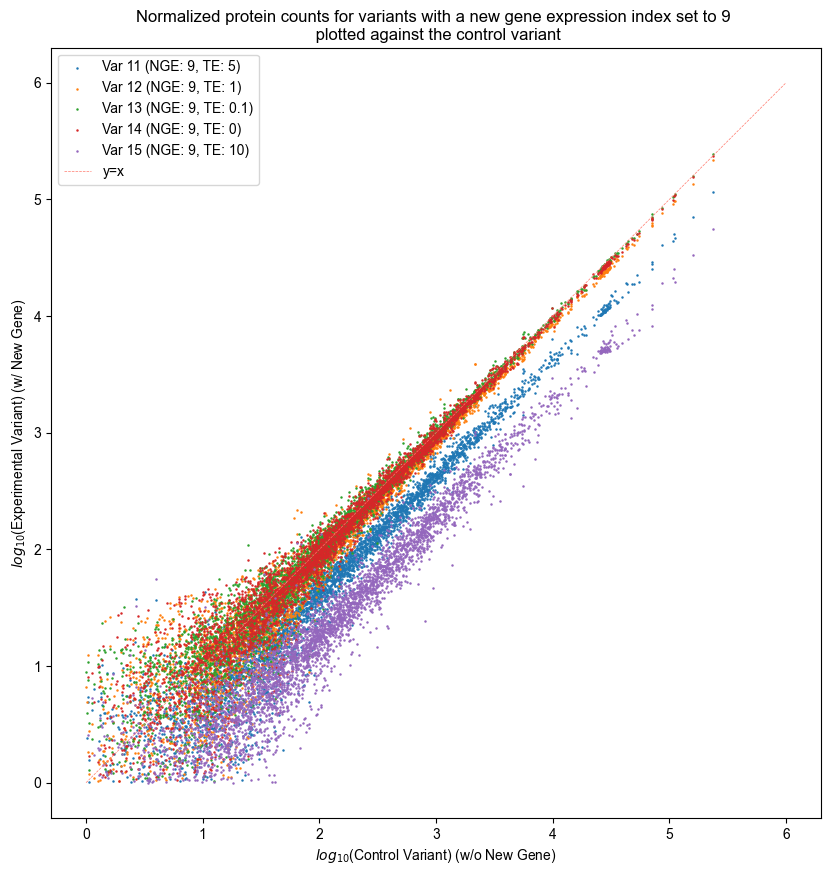

In [9]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(10, 10))

# plot the data:
plt.scatter(v11_log10.log10_Control_Variant, v11_log10.log10_Experimental_Variant, .6);
plt.scatter(v12_log10.log10_Control_Variant, v12_log10.log10_Experimental_Variant, .6);
plt.scatter(v13_log10.log10_Control_Variant, v13_log10.log10_Experimental_Variant, .6);
plt.scatter(v14_log10.log10_Control_Variant, v14_log10.log10_Experimental_Variant, .6);
plt.scatter(v15_log10.log10_Control_Variant, v15_log10.log10_Experimental_Variant, .6);

# find the maximum value:
max_vals = [max(v11_log10.log10_Control_Variant), max(v11_log10.log10_Experimental_Variant), max(v12_log10.log10_Control_Variant), max(v12_log10.log10_Experimental_Variant), max(v13_log10.log10_Control_Variant), max(v13_log10.log10_Experimental_Variant), max(v14_log10.log10_Control_Variant), max(v14_log10.log10_Experimental_Variant), max(v15_log10.log10_Control_Variant), max(v15_log10.log10_Experimental_Variant)]; max_val = round(max(max_vals)) + 1;

# plot a y=x string
yxvals= np.linspace(0, max_val, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str11, str12, str13, str14, str15, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index set to 9 \n plotted against the control variant")

In [10]:
fig = go.Figure()
names11 = v11_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v11_log10.log10_Control_Variant,y=v11_log10.log10_Experimental_Variant, hovertext=names11,
                    mode='markers',
                    name=str11))

names12 = v12_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v12_log10.log10_Control_Variant,y=v12_log10.log10_Experimental_Variant, hovertext=names12,
                    mode='markers',
                    name=str12))

names13 = v13_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v13_log10.log10_Control_Variant,y=v13_log10.log10_Experimental_Variant, hovertext=names13,
                    mode='markers',
                    name=str13))

names14 = v14_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v14_log10.log10_Control_Variant,y=v14_log10.log10_Experimental_Variant, hovertext=names14,
                    mode='markers',
                    name=str14))

names15 = v15_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v15_log10.log10_Control_Variant,y=v15_log10.log10_Experimental_Variant, hovertext=names15,
                    mode='markers',
                    name=str15))

# make the marker size smaller:
fig.update_traces(marker=dict(size=2))

# title and labels:
fig.update_layout(title="Protein counts for experimental variants with a new gene expression index set to 9")


# add axis labels:
fig.update_xaxes(title_text="log10(Control Variant)")
fig.update_yaxes(title_text="log10(Experimental Variant) (w/ New Gene)")

fig.update_layout(
    autosize=False,
    width=1000,
    height=800)
fig.show()

# resize the plot so that only data above 2 is shown:
fig.update_yaxes(range=[2, 6])
fig.update_xaxes(range=[2, 6])
fig.show()

# NEW GENE EXPRESSION INDEX: 10

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index set to 10 \n plotted against the control variant')

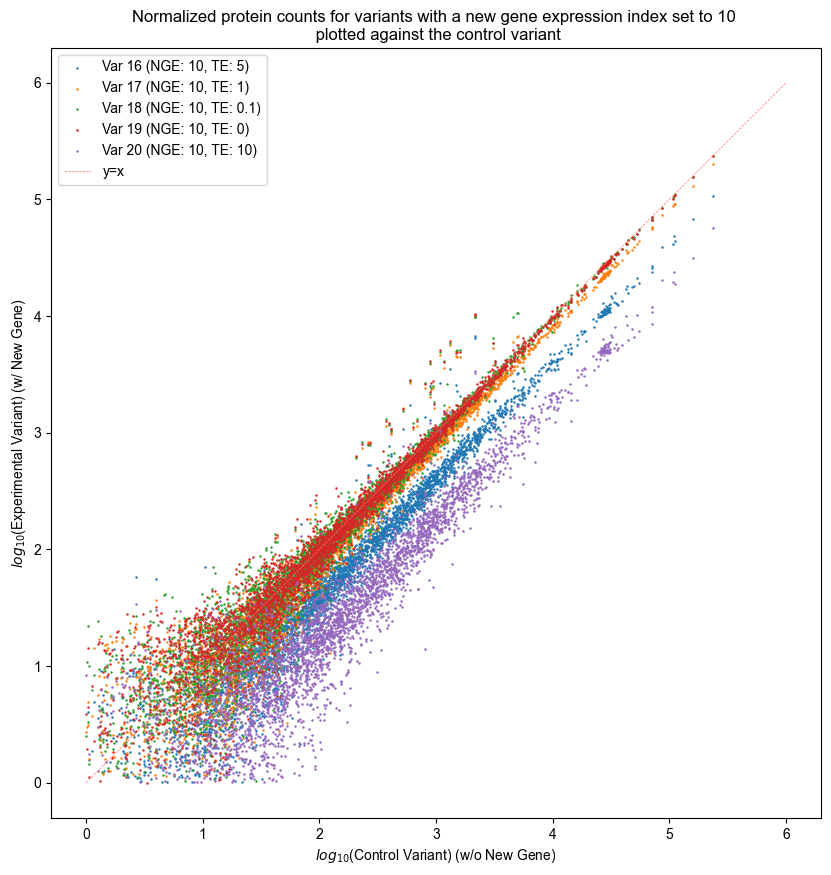

In [11]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(10, 10))

# plot the data:
plt.scatter(v16_log10.log10_Control_Variant, v16_log10.log10_Experimental_Variant, .6);
plt.scatter(v17_log10.log10_Control_Variant, v17_log10.log10_Experimental_Variant, .6);
plt.scatter(v18_log10.log10_Control_Variant, v18_log10.log10_Experimental_Variant, .6);
plt.scatter(v19_log10.log10_Control_Variant, v19_log10.log10_Experimental_Variant, .6);
plt.scatter(v20_log10.log10_Control_Variant, v20_log10.log10_Experimental_Variant, .6);

# find the maximum value:
max_vals = [max(v16_log10.log10_Control_Variant), max(v16_log10.log10_Experimental_Variant), max(v17_log10.log10_Control_Variant), max(v17_log10.log10_Experimental_Variant), max(v18_log10.log10_Control_Variant), max(v18_log10.log10_Experimental_Variant), max(v19_log10.log10_Control_Variant), max(v19_log10.log10_Experimental_Variant), max(v20_log10.log10_Control_Variant), max(v20_log10.log10_Experimental_Variant)]; max_val = round(max(max_vals)) + 1;

# plot a y=x string
yxvals= np.linspace(0, max_val, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str16, str17, str18, str19, str20, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index set to 10 \n plotted against the control variant")


In [12]:
fig = go.Figure()
names16 = v16_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v16_log10.log10_Control_Variant,y=v16_log10.log10_Experimental_Variant, hovertext=names16,
                    mode='markers',
                    name=str16))

names17 = v17_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v17_log10.log10_Control_Variant,y=v17_log10.log10_Experimental_Variant, hovertext=names17,
                    mode='markers',
                    name=str17))

names18 = v18_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v18_log10.log10_Control_Variant,y=v18_log10.log10_Experimental_Variant, hovertext=names18,
                    mode='markers',
                    name=str18))

names19 = v19_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v19_log10.log10_Control_Variant,y=v19_log10.log10_Experimental_Variant, hovertext=names19,
                    mode='markers',
                    name=str19))

names20 = v20_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v20_log10.log10_Control_Variant,y=v20_log10.log10_Experimental_Variant, hovertext=names20,
                    mode='markers',
                    name=str20))

# make the marker size smaller:
fig.update_traces(marker=dict(size=2))

# title and labels:
fig.update_layout(title="Protein counts for experimental variants with a new gene expression index set to 10")

# add axis labels:
fig.update_xaxes(title_text="log10(Control Variant)")
fig.update_yaxes(title_text="log10(Experimental Variant) (w/ New Gene)")

fig.update_layout(
    autosize=False,
    width=1000,
    height=800)
fig.show()

# resize the plot so that only data above 2 is shown:
fig.update_yaxes(range=[2, 5.5])
fig.update_xaxes(range=[2, 5.5])
fig.update_traces(marker=dict(size=4))
fig.show()



# NEW GENE EXPRESSION INDEX: 7 and 8

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index of 7 or 8 \n plotted against the control variant')

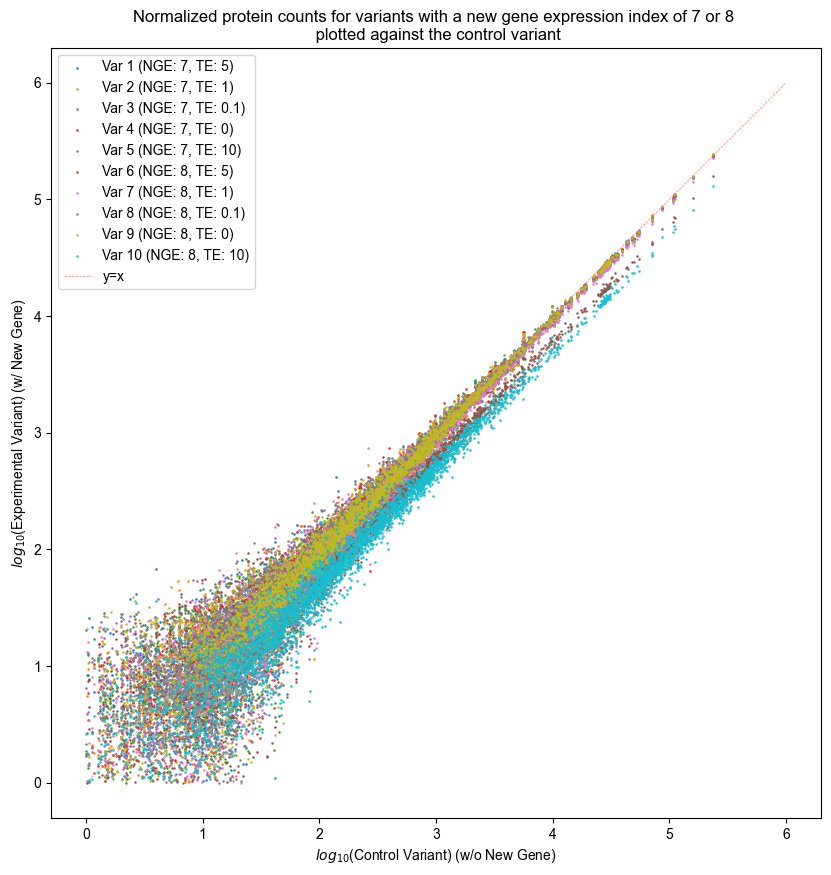

In [13]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(10, 10))

# plot the data:
plt.scatter(v1_log10.log10_Control_Variant, v1_log10.log10_Experimental_Variant, .6);
plt.scatter(v2_log10.log10_Control_Variant, v2_log10.log10_Experimental_Variant, .6);
plt.scatter(v3_log10.log10_Control_Variant, v3_log10.log10_Experimental_Variant, .6);
plt.scatter(v4_log10.log10_Control_Variant, v4_log10.log10_Experimental_Variant, .6);
plt.scatter(v5_log10.log10_Control_Variant, v5_log10.log10_Experimental_Variant, .6);
plt.scatter(v6_log10.log10_Control_Variant, v6_log10.log10_Experimental_Variant, .6);
plt.scatter(v7_log10.log10_Control_Variant, v7_log10.log10_Experimental_Variant, .6);
plt.scatter(v8_log10.log10_Control_Variant, v8_log10.log10_Experimental_Variant, .6);
plt.scatter(v9_log10.log10_Control_Variant, v9_log10.log10_Experimental_Variant, .6);
plt.scatter(v10_log10.log10_Control_Variant, v10_log10.log10_Experimental_Variant, .6);

# plot a y=x string with an estimated max value based on how the other plots looked:
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str1,str2,str3,str4,str5,str6,str7,str8,str9,str10, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index of 7 or 8 \n plotted against the control variant")

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index of 7 or 8 \n plotted against the control variant')

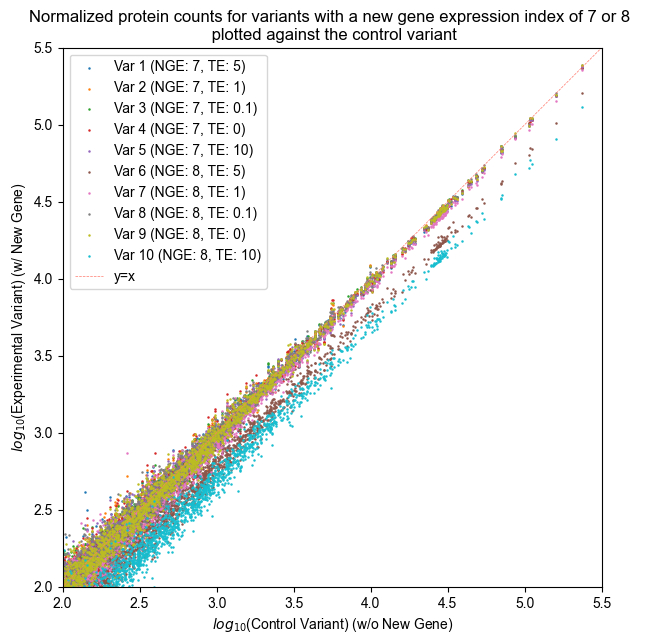

In [14]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(7, 7))

# plot the data:
plt.scatter(v1_log10.log10_Control_Variant, v1_log10.log10_Experimental_Variant, .6);
plt.scatter(v2_log10.log10_Control_Variant, v2_log10.log10_Experimental_Variant, .6);
plt.scatter(v3_log10.log10_Control_Variant, v3_log10.log10_Experimental_Variant, .6);
plt.scatter(v4_log10.log10_Control_Variant, v4_log10.log10_Experimental_Variant, .6);
plt.scatter(v5_log10.log10_Control_Variant, v5_log10.log10_Experimental_Variant, .6);
plt.scatter(v6_log10.log10_Control_Variant, v6_log10.log10_Experimental_Variant, .6);
plt.scatter(v7_log10.log10_Control_Variant, v7_log10.log10_Experimental_Variant, .6);
plt.scatter(v8_log10.log10_Control_Variant, v8_log10.log10_Experimental_Variant, .6);
plt.scatter(v9_log10.log10_Control_Variant, v9_log10.log10_Experimental_Variant, .6);
plt.scatter(v10_log10.log10_Control_Variant, v10_log10.log10_Experimental_Variant, .6);

# plot a y=x string with an estimated max value based on how the other plots looked:
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str1,str2,str3,str4,str5,str6,str7,str8,str9,str10, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlim(2, 5.5); plt.ylim(2, 5.5)
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index of 7 or 8 \n plotted against the control variant")

# NEW GENE EXPRESSION INDEX: 9 and 10

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index of 9 or 10 \n plotted against the control variant')

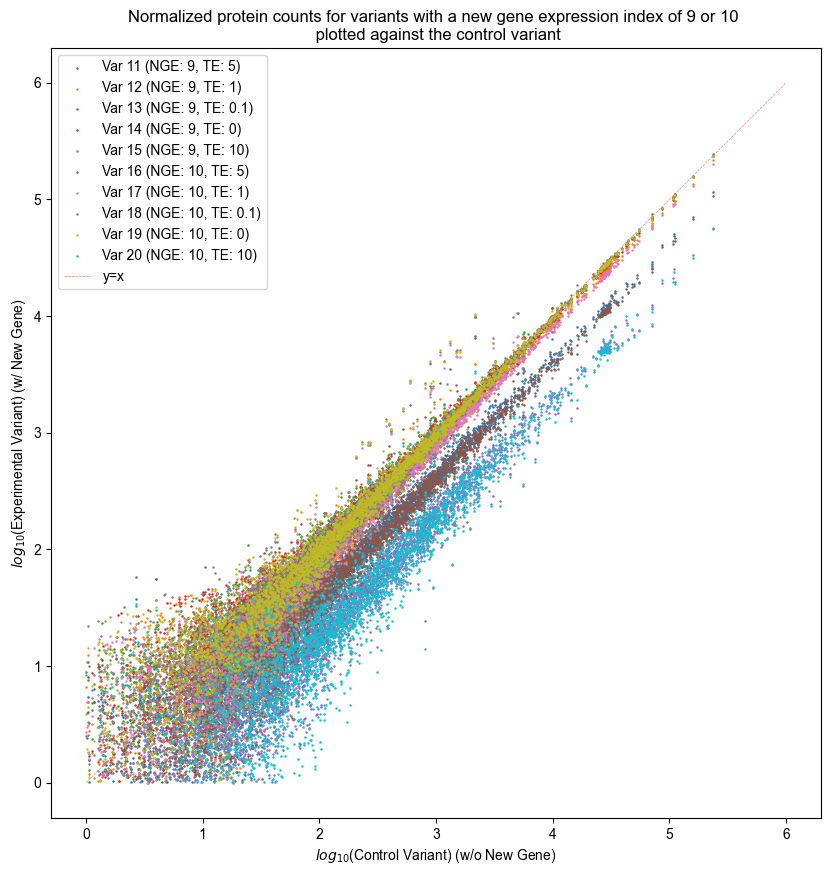

In [15]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(10, 10))

# plot the data:
plt.scatter(v11_log10.log10_Control_Variant, v11_log10.log10_Experimental_Variant, .6);
plt.scatter(v12_log10.log10_Control_Variant, v12_log10.log10_Experimental_Variant, .6);
plt.scatter(v13_log10.log10_Control_Variant, v13_log10.log10_Experimental_Variant, .6);
plt.scatter(v14_log10.log10_Control_Variant, v14_log10.log10_Experimental_Variant, .6);
plt.scatter(v15_log10.log10_Control_Variant, v15_log10.log10_Experimental_Variant, .6);
plt.scatter(v16_log10.log10_Control_Variant, v16_log10.log10_Experimental_Variant, .6);
plt.scatter(v17_log10.log10_Control_Variant, v17_log10.log10_Experimental_Variant, .6);
plt.scatter(v18_log10.log10_Control_Variant, v18_log10.log10_Experimental_Variant, .6);
plt.scatter(v19_log10.log10_Control_Variant, v19_log10.log10_Experimental_Variant, .6);
plt.scatter(v20_log10.log10_Control_Variant, v20_log10.log10_Experimental_Variant, .6);

# plot a y=x string with an estimated max value based on how the other plots looked:
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str11, str12, str13, str14, str15,str16,str17,str18,str19,str20, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index of 9 or 10 \n plotted against the control variant")

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene expression index of 9 or 10 \n plotted against the control variant')

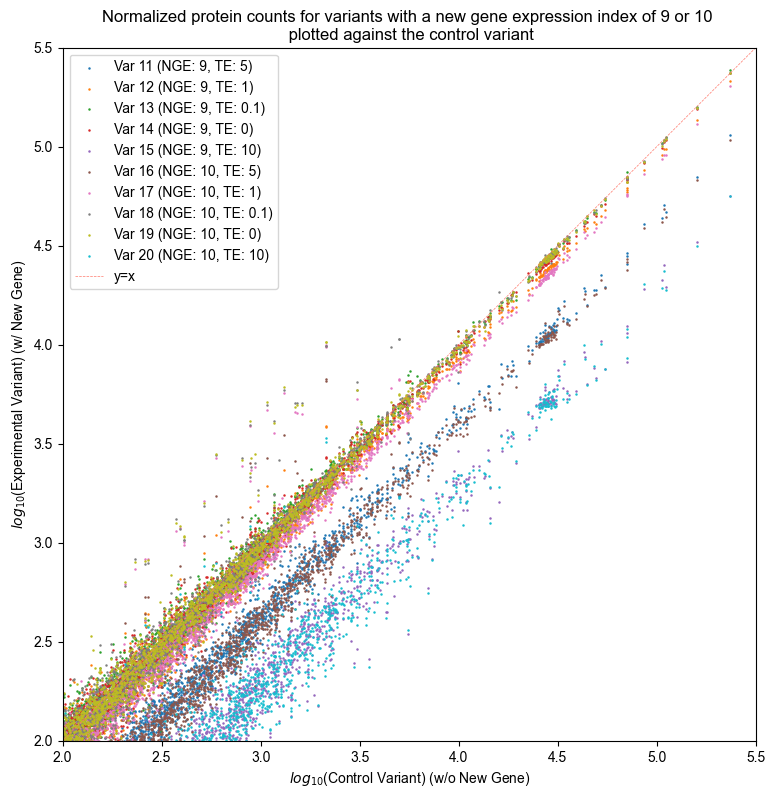

In [16]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(9, 9))

# plot the data:
plt.scatter(v11_log10.log10_Control_Variant, v11_log10.log10_Experimental_Variant, .6);
plt.scatter(v12_log10.log10_Control_Variant, v12_log10.log10_Experimental_Variant, .6);
plt.scatter(v13_log10.log10_Control_Variant, v13_log10.log10_Experimental_Variant, .6);
plt.scatter(v14_log10.log10_Control_Variant, v14_log10.log10_Experimental_Variant, .6);
plt.scatter(v15_log10.log10_Control_Variant, v15_log10.log10_Experimental_Variant, .6);
plt.scatter(v16_log10.log10_Control_Variant, v16_log10.log10_Experimental_Variant, .6);
plt.scatter(v17_log10.log10_Control_Variant, v17_log10.log10_Experimental_Variant, .6);
plt.scatter(v18_log10.log10_Control_Variant, v18_log10.log10_Experimental_Variant, .6);
plt.scatter(v19_log10.log10_Control_Variant, v19_log10.log10_Experimental_Variant, .6);
plt.scatter(v20_log10.log10_Control_Variant, v20_log10.log10_Experimental_Variant, .6);

# plot a y=x string with an estimated max value based on how the other plots looked:
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str11, str12, str13, str14, str15,str16,str17,str18,str19,str20, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlim(2, 5.5); plt.ylim(2, 5.5)
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene expression index of 9 or 10 \n plotted against the control variant")

In [17]:
fig = go.Figure()
names11 = v11_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v11_log10.log10_Control_Variant,y=v11_log10.log10_Experimental_Variant, hovertext=names11,
                    mode='markers',
                    name=str11))

names12 = v12_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v12_log10.log10_Control_Variant,y=v12_log10.log10_Experimental_Variant, hovertext=names12,
                    mode='markers',
                    name=str12))

names13 = v13_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v13_log10.log10_Control_Variant,y=v13_log10.log10_Experimental_Variant, hovertext=names13,
                    mode='markers',
                    name=str13))

names14 = v14_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v14_log10.log10_Control_Variant,y=v14_log10.log10_Experimental_Variant, hovertext=names14,
                    mode='markers',
                    name=str14))

names15 = v15_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v15_log10.log10_Control_Variant,y=v15_log10.log10_Experimental_Variant, hovertext=names15,
                    mode='markers',
                    name=str15))

names16 = v16_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v16_log10.log10_Control_Variant,y=v16_log10.log10_Experimental_Variant, hovertext=names16,
                    mode='markers',
                    name=str16))

names17 = v17_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v17_log10.log10_Control_Variant,y=v17_log10.log10_Experimental_Variant, hovertext=names17,
                    mode='markers',
                    name=str17))

names18 = v18_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v18_log10.log10_Control_Variant,y=v18_log10.log10_Experimental_Variant, hovertext=names18,
                    mode='markers',
                    name=str18))

names19 = v19_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v19_log10.log10_Control_Variant,y=v19_log10.log10_Experimental_Variant, hovertext=names19,
                    mode='markers',
                    name=str19))

names20 = v20_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v20_log10.log10_Control_Variant,y=v20_log10.log10_Experimental_Variant, hovertext=names20,
                    mode='markers',
                    name=str20))


# make the marker size smaller:
fig.update_traces(marker=dict(size=2))

# title and labels:
fig.update_layout(title="Protein counts for experimental variants with a new gene expression index set to 9 or 10")


# add axis labels:
fig.update_xaxes(title_text="log10(Control Variant)")
fig.update_yaxes(title_text="log10(Experimental Variant) (w/ New Gene)")

fig.update_layout(
    autosize=False,
    width=1000,
    height=800)
fig.show()

# resize the plot so that only data above 2 is shown:
fig.update_yaxes(range=[2, 6])
fig.update_xaxes(range=[2, 6])
fig.show()


# Plot by the translation efficiency now!

# NEW GENE TRANSLATION EFFICENCY: 0

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene translation efficency of 0 \n plotted against the control variant')

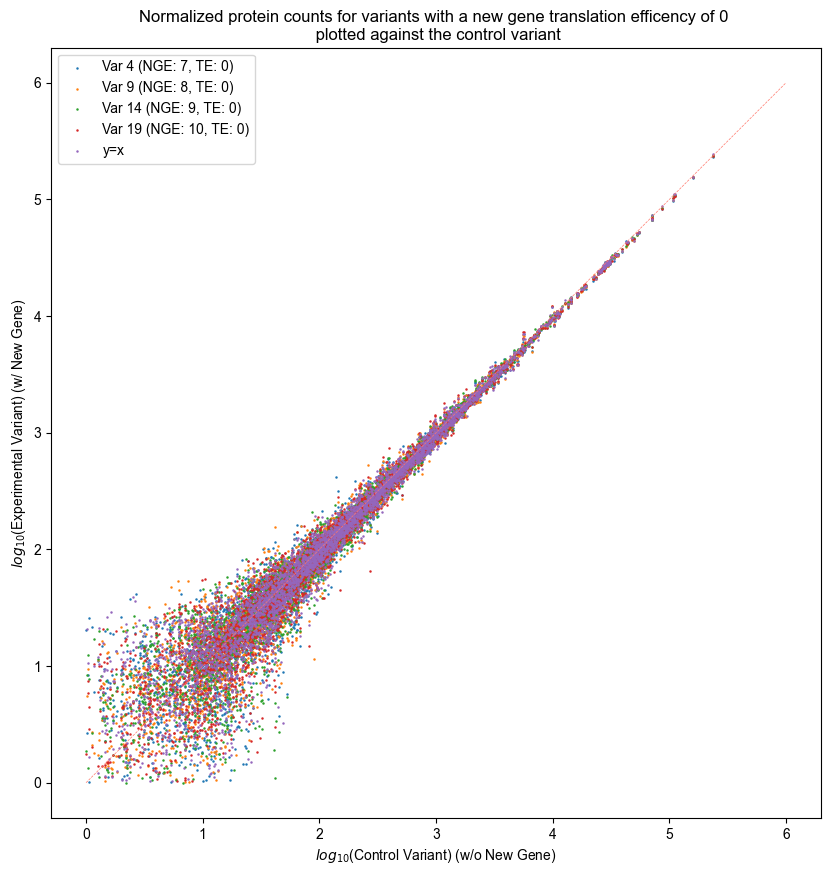

In [18]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(10, 10))

# plot the data:
plt.scatter(v1_log10.log10_Control_Variant, v1_log10.log10_Experimental_Variant, .6);
plt.scatter(v2_log10.log10_Control_Variant, v2_log10.log10_Experimental_Variant, .6);
plt.scatter(v3_log10.log10_Control_Variant, v3_log10.log10_Experimental_Variant, .6);
plt.scatter(v4_log10.log10_Control_Variant, v4_log10.log10_Experimental_Variant, .6);
plt.scatter(v9_log10.log10_Control_Variant, v9_log10.log10_Experimental_Variant, .6);

# plot a y=x string
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str4, str9, str14, str19, yxstr]


plt.legend(legend)
plt.axis('square')
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene translation efficency of 0 \n plotted against the control variant")

# NEW GENE TRANSLATION EFFICENCY: 0.1

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene translation efficency of 0.1 \n plotted against the control variant')

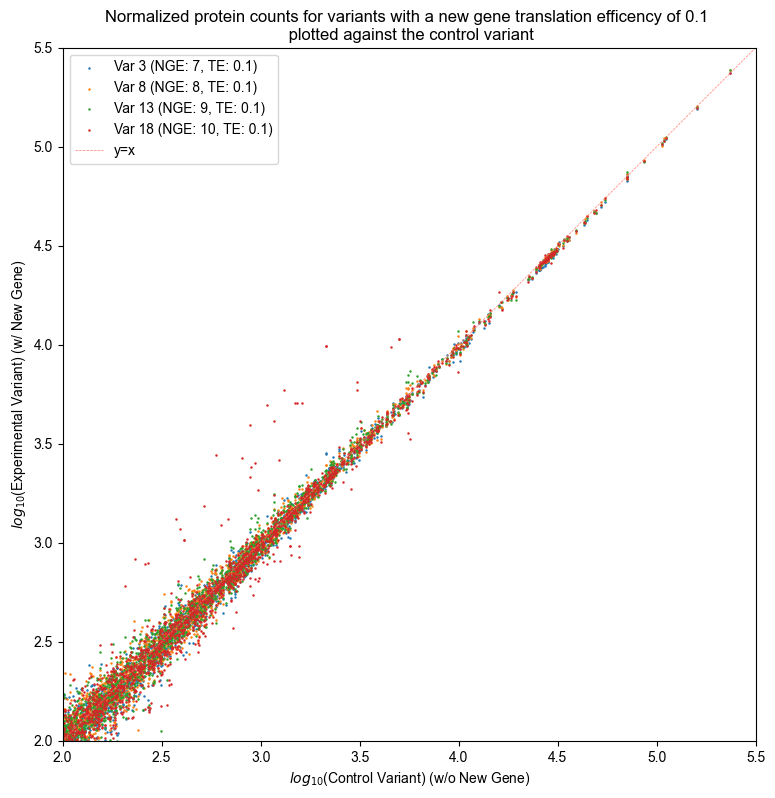

In [19]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(9, 9))

# plot the data:
plt.scatter(v3_log10.log10_Control_Variant, v3_log10.log10_Experimental_Variant, .6);
plt.scatter(v8_log10.log10_Control_Variant, v8_log10.log10_Experimental_Variant, .6);
plt.scatter(v13_log10.log10_Control_Variant, v13_log10.log10_Experimental_Variant, .6);
plt.scatter(v18_log10.log10_Control_Variant, v18_log10.log10_Experimental_Variant, .6);

# plot a y=x string
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str3, str8, str13, str18, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlim(2, 5.5); plt.ylim(2, 5.5)
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene translation efficency of 0.1 \n plotted against the control variant")

In [20]:
fig = go.Figure()
names3 = v3_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v3_log10.log10_Control_Variant,y=v3_log10.log10_Experimental_Variant, hovertext=names3,
                    mode='markers',
                    name=str3))

names8 = v8_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v8_log10.log10_Control_Variant,y=v8_log10.log10_Experimental_Variant, hovertext=names8,
                    mode='markers',
                    name=str8))

names13 = v13_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v13_log10.log10_Control_Variant,y=v13_log10.log10_Experimental_Variant, hovertext=names13,
                    mode='markers',
                    name=str13))

names18 = v18_log10.filtered_monomer_ids
fig.add_trace(go.Scatter(x=v18_log10.log10_Control_Variant,y=v18_log10.log10_Experimental_Variant, hovertext=names18,
                    mode='markers',
                    name=str18))

# make the marker size smaller:
fig.update_traces(marker=dict(size=2))

# title and labels:
fig.update_layout(title="Protein counts for experimental variants with a new gene translation efficency set to 0.1")

# add axis labels:
fig.update_xaxes(title_text="log10(Control Variant)")
fig.update_yaxes(title_text="log10(Experimental Variant) (w/ New Gene)")

fig.update_layout(
    autosize=False,
    width=1000,
    height=800)
fig.show()

# resize the plot so that only data above 2 is shown:
fig.update_yaxes(range=[2, 6])
fig.update_xaxes(range=[2, 6])
fig.show()


# NEW GENE TRANSLATION EFFICENCY: 1

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene translation efficency of 1 \n plotted against the control variant')

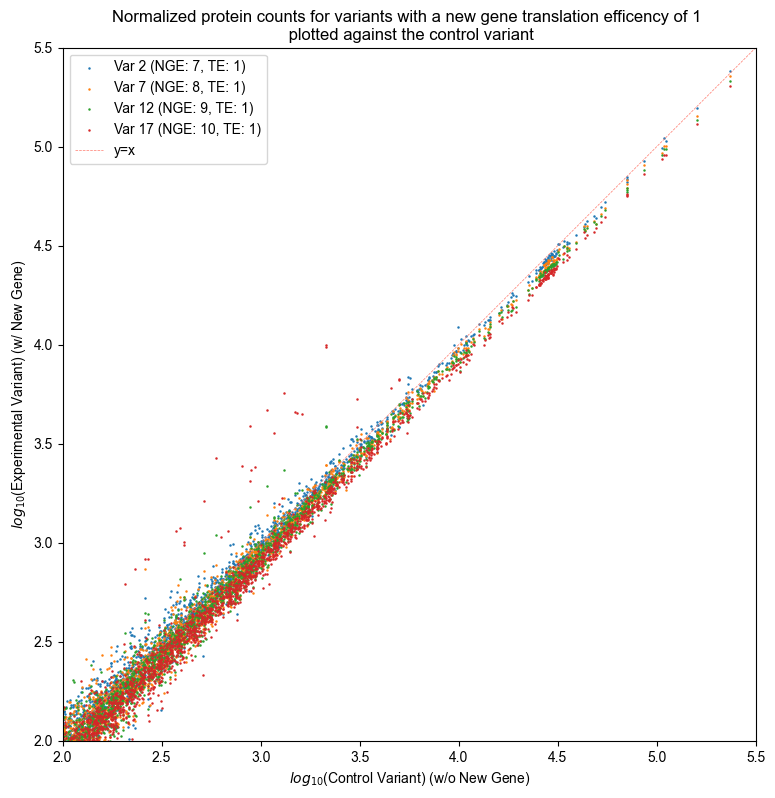

In [21]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(9, 9))

# plot the data:
plt.scatter(v2_log10.log10_Control_Variant, v2_log10.log10_Experimental_Variant, .6);
plt.scatter(v7_log10.log10_Control_Variant, v7_log10.log10_Experimental_Variant, .6);
plt.scatter(v12_log10.log10_Control_Variant, v12_log10.log10_Experimental_Variant, .6);
plt.scatter(v17_log10.log10_Control_Variant, v17_log10.log10_Experimental_Variant, .6);

# plot a y=x string
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str2, str7, str12, str17, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlim(2, 5.5); plt.ylim(2, 5.5)
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene translation efficency of 1 \n plotted against the control variant")

# NEW GENE TRANSLATION EFFICENCY: 5

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene translation efficency of 5 \n plotted against the control variant')

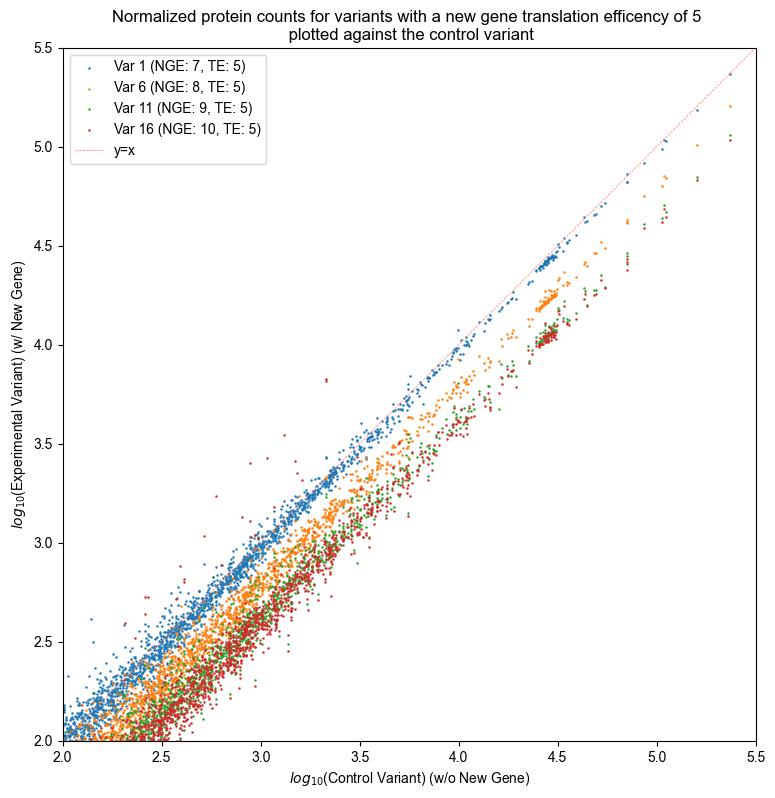

In [22]:
# plot all log data. Plot x = control, y = experimental:

plt.figure(figsize=(9, 9))

# plot the data:
plt.scatter(v1_log10.log10_Control_Variant, v1_log10.log10_Experimental_Variant, .6);
plt.scatter(v6_log10.log10_Control_Variant, v6_log10.log10_Experimental_Variant, .6);
plt.scatter(v11_log10.log10_Control_Variant, v11_log10.log10_Experimental_Variant, .6);
plt.scatter(v16_log10.log10_Control_Variant, v16_log10.log10_Experimental_Variant, .6);

# plot a y=x string
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str1, str6, str11, str16, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlim(2, 5.5); plt.ylim(2, 5.5)
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene translation efficency of 5 \n plotted against the control variant")


# NEW GENE TRANSLATION EFFICENCY: 10

Text(0.5, 1.0, 'Normalized protein counts for variants with a new gene translation efficency of 10 \n plotted against the control variant')

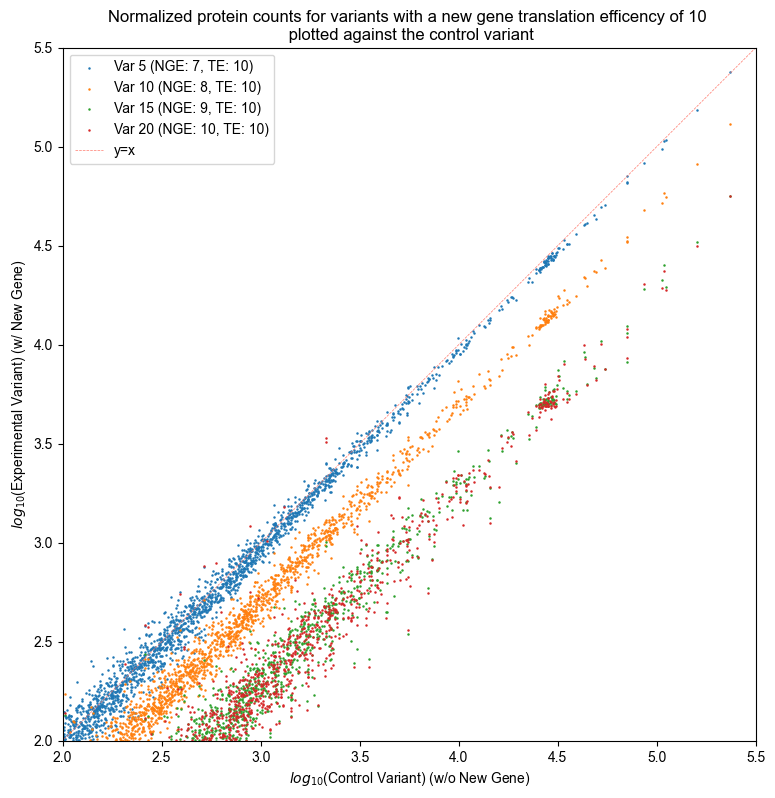

In [23]:
# plot all log data. Plot x = control, y = experimental:
plt.figure(figsize=(9, 9))

# plot the data:
plt.scatter(v5_log10.log10_Control_Variant, v5_log10.log10_Experimental_Variant, .6);
plt.scatter(v10_log10.log10_Control_Variant, v10_log10.log10_Experimental_Variant, .6);
plt.scatter(v15_log10.log10_Control_Variant, v15_log10.log10_Experimental_Variant, .6);
plt.scatter(v20_log10.log10_Control_Variant, v20_log10.log10_Experimental_Variant, .6);

# plot a y=x string
yxvals= np.linspace(0, 6, 100)
plt.plot(yxvals, yxvals, linewidth=.5, linestyle="dashed", color="#FF796C"); yxstr = "y=x"
legend = [str5, str10, str15, str20, yxstr]

plt.legend(legend)
plt.axis('square')
plt.xlim(2, 5.5); plt.ylim(2, 5.5)
plt.xlabel("$log_{10}$(Control Variant) (w/o New Gene)")
plt.ylabel("$log_{10}$(Experimental Variant) (w/ New Gene)")
plt.title(f"Normalized protein counts for variants with a new gene translation efficency of 10 \n plotted against the control variant")
